V1

In [3]:
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]  # Hier einfach deine Ordnernamen eintragen
base_path = "data"  # Der Pfad zu deinem Hauptverzeichnis mit den Ordnern

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                # CSV-Datei lesen
                csv_data = pd.read_csv(file_path)
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder  # Ordnername als Label
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

# === 4. Textdaten vorbereiten: Tokenisierung ===
# Tokenizer erstellen und auf Trainingsdaten anpassen
tokenizer = Tokenizer(num_words=5000, oov_token="<UNK>")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Textdaten in Sequenzen umwandeln
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="tfidf")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="tfidf")

# Labels in numerische Werte umwandeln
label_map = {folder: idx for idx, folder in enumerate(folders)}  # Ordner zu Index
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# === 5. Modell erstellen ===
model = Sequential([
    Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
    Dense(64, activation='relu'),
    Dense(len(folders), activation='softmax')  # Ausgabe hat so viele Klassen wie Ordner
])

# Modell kompilieren
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 6. Modell trainieren ===
model.fit(x_train, y_train, epochs=1000, batch_size=16, validation_data=(x_test, y_test))

# === 7. Belohnungssystem simulieren ===
def reward_system(predicted_folder, true_folder):
    if predicted_folder == true_folder:
        return 1  # Richtige Zuordnung
    else:
        return -1  # Falsche Zuordnung

# === 8. Aufgaben: Vorhersagen und Belohnung auswerten ===
def evaluate_model(data, tokenizer, model, label_map, folders):
    score = 0
    for _, row in data.iterrows():
        # Text in Matrix umwandeln
        x = tokenizer.texts_to_matrix([row["Inhalt"]], mode="tfidf")
        # Vorhersage durchführen
        predictions = model.predict(x)
        predicted_label = folders[np.argmax(predictions)]  # Index zurück in Ordnername
        true_label = row["Label"]

        # Belohnung berechnen
        reward = reward_system(predicted_label, true_label)
        score += reward

        print(f"Betreff: {row['Betreff']}, Vorhergesagt: {predicted_label}, Korrekt: {true_label}, Belohnung: {reward}")
    return score

# Modell bewerten
final_score = evaluate_model(test_data, tokenizer, model, label_map, folders)
print(f"Gesamte Belohnung: {final_score}")

Epoch 1/1000


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 668ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 8/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0

V1.1

In [1]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]  # Hier einfach deine Ordnernamen eintragen
base_path = "data"  # Der Pfad zu deinem Hauptverzeichnis mit den Ordnern

# === 2. Daten import: CSV-Dateien Laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                csv_data = pd.read_csv(file_path)
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder  # Ordnername als Label
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

# === 4. Textdaten vorbereiten: Tokenisierung ===
# Tokenizer erstellen und auf Trainingsdaten anpassen
tokenizer = Tokenizer(num_words=5000, oov_token="UNK")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Textdaten in Sequenzen umwandeln
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="tfidf")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="tfidf")

# Labels in numerische Werte umwandeln
label_map = {folder: idx for idx, folder in enumerate(folders)}  # Ordner zu Index
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# === 5. Modell erstellen oder laden ===
model = load_model('2 AI epochs10000 V1.1.h5')  # Laden

model_path = "model.h5"
if os.path.exists(model_path):
    print("Vorhandenes Modell wird geladen...")
    model = load_model(model_path)  # Vorhandenes Modell laden
else:
    print("Neues Modell wird erstellt...")
    model = Sequential([
        Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
        Dense(64, activation='relu'),
        Dense(len(folders), activation='softmax')  # Ausgabe hat so viele Klassen wie Ordner
    ])
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 6. Modell trainieren ===
model.fit(x_train, y_train, epochs=5000, batch_size=16, validation_data=(x_test, y_test))

# === 7. Belohnungssystem simulieren ===
def reward_system(predicted_folder, true_folder):
    if predicted_folder == true_folder:
        return 1  # Richtige Zuordnung
    else:
        return 0  # Falsche Zuordnung

# === 8. Aufgaben: Vorhersagen und Belohnung auswerten ===
def evaluate_model(data, tokenizer, model, label_map, folders):
    score = 0
    for _, row in data.iterrows():
        # Text in Matrix umwandeln
        x = tokenizer.texts_to_matrix([row["Inhalt"]], mode="tfidf")
        
        # Vorhersage durchführen
        predictions = model.predict(x)
        predicted_label = folders[np.argmax(predictions)]  # Index zurück in Ordnername
        true_label = row["Label"]

        # Belohnung berechnen
        reward = reward_system(predicted_label, true_label)
        score += reward

        print(f"Betreff: {row['Betreff']}, Vorhergesagt: {predicted_label}, Korrekt: {true_label}, Belohnung: {reward}")
    
    return score

model.save('2 AI epochs50000 V1.1.h5') # Speichern
# Modell bewerten
final_score = evaluate_model(test_data, tokenizer, model, label_map, folders)
print(f"Gesamtpunkte: {final_score}")

Vorhandenes Modell wird geladen...
Epoch 1/5000


NotImplementedError: numpy() is only available when eager execution is enabled.

V1.1.1

In [3]:
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]  # Hier einfach deine Ordnernamen eintragen
base_path = "data"  # Der Pfad zu deinem Hauptverzeichnis mit den Ordnern

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                # CSV-Datei lesen
                csv_data = pd.read_csv(file_path)
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder  # Ordnername als Label
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

# === 4. Textdaten vorbereiten: Tokenisierung ===
# Tokenizer erstellen und auf Trainingsdaten anpassen
tokenizer = Tokenizer(num_words=5000, oov_token="<UNK>")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Textdaten in Sequenzen umwandeln
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="tfidf")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="tfidf")

# Labels in numerische Werte umwandeln
label_map = {folder: idx for idx, folder in enumerate(folders)}  # Ordner zu Index
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# Model laden
model = load_model('2 AI epochs50000 V1.1.h5')

# === 5. Modell erstellen ===
model = Sequential([
    Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
    Dense(64, activation='relu'),
    Dense(len(folders), activation='softmax')  # Ausgabe hat so viele Klassen wie Ordner
])

# Modell kompilieren
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 6. Modell trainieren ===
model.fit(x_train, y_train, epochs=40000, batch_size=16, validation_data=(x_test, y_test))

# === 7. Belohnungssystem simulieren ===
def reward_system(predicted_folder, true_folder):
    if predicted_folder == true_folder:
        return 1  # Richtige Zuordnung
    else:
        return 0  # Falsche Zuordnung

# === 8. Aufgaben: Vorhersagen und Belohnung auswerten ===
def evaluate_model(data, tokenizer, model, label_map, folders):
    score = 0
    for _, row in data.iterrows():
        # Text in Matrix umwandeln
        x = tokenizer.texts_to_matrix([row["Inhalt"]], mode="tfidf")
        # Vorhersage durchführen
        predictions = model.predict(x)
        predicted_label = folders[np.argmax(predictions)]  # Index zurück in Ordnername
        true_label = row["Label"]

        # Belohnung berechnen
        reward = reward_system(predicted_label, true_label)
        score += reward

        print(f"Betreff: {row['Betreff']}, Vorhergesagt: {predicted_label}, Korrekt: {true_label}, Belohnung: {reward}")
    return score

#Model Speichern
model.save('2 AI epochs100000 V1.1.h5')

# Modell bewerten
final_score = evaluate_model(test_data, tokenizer, model, label_map, folders)
print(f"Gesamte Belohnung: {final_score}")

Epoch 1/40000


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 8/40000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_lo

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Betreff: Zahlungserinnerung, Vorhergesagt: Werbung, Korrekt: Finanzen, Belohnung: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Betreff: Neues Produkt erhältlich, Vorhergesagt: Werbung, Korrekt: Werbung, Belohnung: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Betreff: Projektplan für nächste Woche, Vorhergesagt: Werbung, Korrekt: Arbeit, Belohnung: 0
Gesamte Belohnung: 1


V1.2

In [3]:
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]  # Hier einfach deine Ordnernamen eintragen
base_path = "data"  # Der Pfad zu deinem Hauptverzeichnis mit den Ordnern

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                # CSV-Datei lesen
                csv_data = pd.read_csv(file_path)
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder  # Ordnername als Label
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.8, random_state=42)

# === 4. Textdaten vorbereiten: Tokenisierung ===
# Tokenizer erstellen und auf Trainingsdaten anpassen
tokenizer = Tokenizer(num_words=10000, oov_token="UNK")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Textdaten in Sequenzen umwandeln
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="tfidf")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="tfidf")

# Labels in numerische Werte umwandeln
label_map = {folder: idx for idx, folder in enumerate(folders)}  # Ordner zu Index
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# Model laden
model = load_model('2 AI epochs211000 V1.2.h5')

# === 5. Modell erstellen ===
model = Sequential([
    Dense(256, activation='relu', input_shape=(x_train.shape[1],)), 
    Dense(128, activation='relu'),
    Dense(len(folders), activation='softmax')  # Ausgabe hat so viele Klassen wie Ordner
])

# Modell kompilieren
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 6. Modell trainieren ===
model.fit(x_train, y_train, epochs=1000, batch_size=16, validation_data=(x_test, y_test))

# === 7. Belohnungssystem simulieren ===
def reward_system(predicted_folder, true_folder):
    if predicted_folder == true_folder:
        return 1  # Richtige Zuordnung
    else:
        return 0  # Falsche Zuordnung

# === 8. Aufgaben: Vorhersagen und Belohnung auswerten ===
def evaluate_model(data, tokenizer, model, label_map, folders):
    correct_counts = {folder: 0 for folder in folders}  # Zähler für korrekte Vorhersagen
    total_counts = {folder: 0 for folder in folders}  # Gesamtanzahl der E-Mails pro Ordner
    
    for _, row in data.iterrows():
        folder = row["Label"]
        total_counts[folder] += 1  # Gesamtanzahl pro Ordner erhöhen

        # Text in Matrix umwandeln
        x = tokenizer.texts_to_matrix([row["Inhalt"]], mode="tfidf")
        
        # Vorhersage durchführen
        predictions = model.predict(x)
        predicted_label = folders[np.argmax(predictions)]  # Index zurück in Ordnername
        true_label = row["Label"]

        # Belohnung berechnen
        if predicted_label == true_label:
            correct_counts[true_label] += 1

    # Ergebnisse ausgeben
    for folder in folders:
        print(f"{folder}: {correct_counts[folder]} / {total_counts[folder]} E-Mails korrekt")

    return sum(correct_counts.values())  # Gesamtsumme zurückgeben
#----------------------------------------------------------------------------------------------
#Testen
for i in range(10):
    x = tokenizer.texts_to_matrix([test_data['Inhalt'].iloc[i]], mode="tfidf")
    prediction = model.predict(x)
    print(f"Original: {test_data['Label'].iloc[i]}, Prediction: {folders[np.argmax(prediction)]}")

print(train_data['Label'].value_counts())

for i in range(len(test_data)):
    x = tokenizer.texts_to_matrix([test_data["Inhalt"].iloc[i]], mode="tfidf")
    prediction = model.predict(x)
    print(f"Original: {test_data['Label'].iloc[i]}")
    print(f"Prediction: {folders[np.argmax(prediction)]}")
    print(f"Confidence Scores: {prediction}")

#----------------------------------------------------------------------------------------------
#Model Speichern
model.save('2 AI epochs212000 V1.2.h5')

# Modell bewerten
final_score = evaluate_model(test_data, tokenizer, model, label_map, folders)
print(f"Gesamte Belohnung: {final_score}")

Epoch 1/1000


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 8/1000
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - accuracy: 0.3333 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0

Original: Werbung
Prediction: Arbeit
Confidence Scores: [[0.33333334 0.33333334 0.33333334]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Arbeit: 4 / 4 E-Mails korrekt
Finanzen: 0 / 4 E-Mails korrekt
Werbung: 0 / 4 E-Mails korrekt
Gesamte Belohnung: 4


V1.3

Datenverteilung im Training:
Label
Werbung     7
Arbeit      7
Finanzen    7
Name: count, dtype: int64
Epoch 1/4000


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 151ms/step - accuracy: 0.3472 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - accuracy: 0.3681 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.3264 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.3681 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.3472 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.3264 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.3264 - loss: 1.0988 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 8/4000
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.3472 - loss: 1.0985 - val_accuracy: 0.3333 - val_loss: 1.0

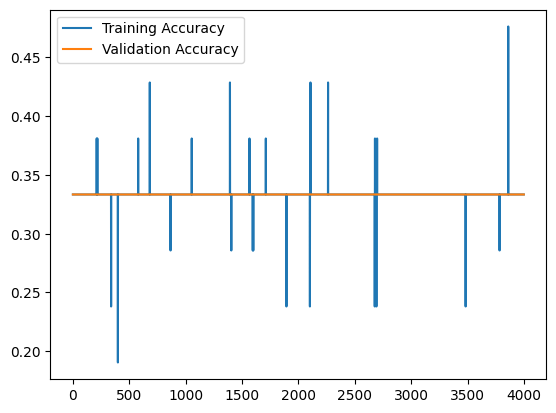

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Original: Arbeit
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Original: Werbung
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Original: Werbung
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Original: Finanzen
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Original: Arbeit
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Original: Finanzen
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Original: Werbung
Prediction: Arbeit
Confidence Scores: [[0.33665335 0.3323618  0.33098495]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Original: Arbeit
Prediction: Ar

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]
base_path = "data"

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                csv_data = pd.read_csv(file_path, encoding="ISO-8859-1")  # Oder encoding="latin1"
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.3, random_state=42, stratify=data["Label"])

# === 4. Trainingsdaten prüfen ===
print("Datenverteilung im Training:")
print(train_data['Label'].value_counts())

# === 5. Textdaten vorbereiten: Tokenisierung ===
tokenizer = Tokenizer(num_words=10000, oov_token="UNK")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Modus wählen (Test: count statt tfidf)
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="count")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="count")

label_map = {folder: idx for idx, folder in enumerate(folders)}
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# Model laden
model = load_model('2 AI epochs1000 V1.3.h5')

# === 6. Modell erstellen (Alternative mit LSTM) ===
model = Sequential([
    Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
    Dense(64, activation='relu'),
    Dense(len(folders), activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 7. Modell trainieren und Accuracy plotten ===
history = model.fit(x_train, y_train, epochs=4000, batch_size=16, validation_data=(x_test, y_test))

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.show()

# === 8. Modell speichern ===
model.save('2 AI epochs5000 V1.3.h5')

# === 9. Testen ===
def test_model(data, tokenizer, model, folders):
    for i in range(len(data)):
        x = tokenizer.texts_to_matrix([data["Inhalt"].iloc[i]], mode="count")
        prediction = model.predict(x)
        print(f"Original: {data['Label'].iloc[i]}")
        print(f"Prediction: {folders[np.argmax(prediction)]}")
        print(f"Confidence Scores: {prediction}")
        print("-")

test_model(test_data, tokenizer, model, folders)

# Modell bewerten

#-----------------------------------------------------------------------------
#test


V1.3.1

Datenverteilung im Training:
Label
Werbung     14
Arbeit      14
Finanzen    14
Name: count, dtype: int64
Epoch 1/50000


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step - accuracy: 0.3620 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.3854 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - accuracy: 0.3229 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.2481 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.2917 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.3464 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.3073 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 8/50000
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.3620 - loss: 1.0986 - val_accuracy: 0.3333 - val_los

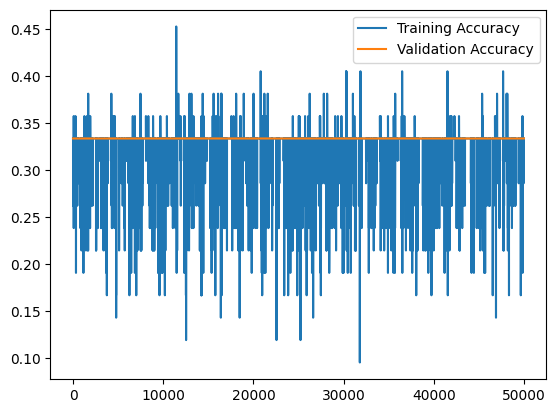

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Original: Werbung
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Original: Finanzen
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Original: Arbeit
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Original: Arbeit
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Original: Werbung
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Original: Werbung
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Original: Werbung
Prediction: Werbung
Confidence Scores: [[0.33437496 0.3307918  0.3348332 ]]
-
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Original: Arbeit
Predicti

In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical
from collections import defaultdict

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]
base_path = "data"

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                csv_data = pd.read_csv(file_path, encoding="ISO-8859-1")  # Oder encoding="latin1"
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.3, random_state=42, stratify=data["Label"])

# === 4. Trainingsdaten prüfen ===
print("Datenverteilung im Training:")
print(train_data['Label'].value_counts())

# === 5. Textdaten vorbereiten: Tokenisierung ===
tokenizer = Tokenizer(num_words=10000, oov_token="UNK")
tokenizer.fit_on_texts(train_data["Inhalt"])

# Modus wählen (Test: count statt tfidf)
x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="count")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="count")

label_map = {folder: idx for idx, folder in enumerate(folders)}
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# Model laden
model = load_model('2 AI epochs150000 V1.3.1.h5')

# === 6. Modell erstellen (Alternative mit LSTM) ===
model = Sequential([
    Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
    Dense(64, activation='relu'),
    Dense(len(folders), activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 7. Modell trainieren und Accuracy plotten ===
history = model.fit(x_train, y_train, epochs=50000, batch_size=16, validation_data=(x_test, y_test))

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.show()

# === 8. Modell speichern ===
model.save('2 AI epochs200000 V1.3.1.h5')

# === 9. Testen ===
def test_model(data, tokenizer, model, folders):
    for i in range(len(data)):
        x = tokenizer.texts_to_matrix([data["Inhalt"].iloc[i]], mode="count")
        prediction = model.predict(x)
        print(f"Original: {data['Label'].iloc[i]}")
        print(f"Prediction: {folders[np.argmax(prediction)]}")
        print(f"Confidence Scores: {prediction}")
        print("-")

test_model(test_data, tokenizer, model, folders)

# === 10. Evaluierung der Klassifikation ===
def evaluate_email_classification(test_data, tokenizer, model, folders):
    correct_counts = {label: 0 for label in folders}  # Richtige Zuordnungen pro Label
    total_counts = {label: 0 for label in folders}    # Gesamtanzahl pro Label

    for _, row in test_data.iterrows():
        email_text = row["Betreff"] + " " + row["Inhalt"]
        true_label = row["Label"]
        
        # Falls es ein unbekanntes Label gibt, es ignorieren
        if true_label not in folders:
            continue

        # E-Mail in Zahlen umwandeln (Tokenizing)
        email_sequence = tokenizer.texts_to_matrix([email_text], mode="count")
        
        # Modell Vorhersage
        prediction = model.predict(email_sequence, verbose=0)
        predicted_label = folders[np.argmax(prediction)]  # Label mit höchster Wahrscheinlichkeit

        # Statistik aktualisieren
        total_counts[true_label] += 1
        if predicted_label == true_label:
            correct_counts[true_label] += 1

    # Ergebnisse ausgeben
    print("\n📊 **Auswertung der E-Mail-Klassifikation:**\n")
    for label in folders:  # Alle Labels durchgehen
        correct = correct_counts.get(label, 0)  # Falls nicht vorhanden, 0 setzen
        total = total_counts.get(label, 0)
        accuracy = (correct / total) * 100 if total > 0 else 0
        print(f"✅ {label}: {correct} von {total} korrekt einsortiert ({accuracy:.2f}%)")

    # Gesamtergebnis berechnen
    overall_correct = sum(correct_counts.values())
    overall_total = sum(total_counts.values())
    overall_accuracy = (overall_correct / overall_total) * 100 if overall_total > 0 else 0
    print(f"\n🎯 **Gesamte Klassifikationsgenauigkeit: {overall_accuracy:.2f}%**")

    return correct_counts, total_counts

# Evaluierung starten
correct_counts, total_counts = evaluate_email_classification(test_data, tokenizer, model, folders)


V1.4

Epoch 1/200


C:\Users\Luca\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step - accuracy: 0.3542 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 2/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.3346 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 3/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.3174 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 4/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.2795 - loss: 1.0987 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 5/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.3268 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 6/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.3346 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986
Epoch 7/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.3268 - loss: 1.0986 - val_accuracy: 0.3333 - val_loss: 1.0986


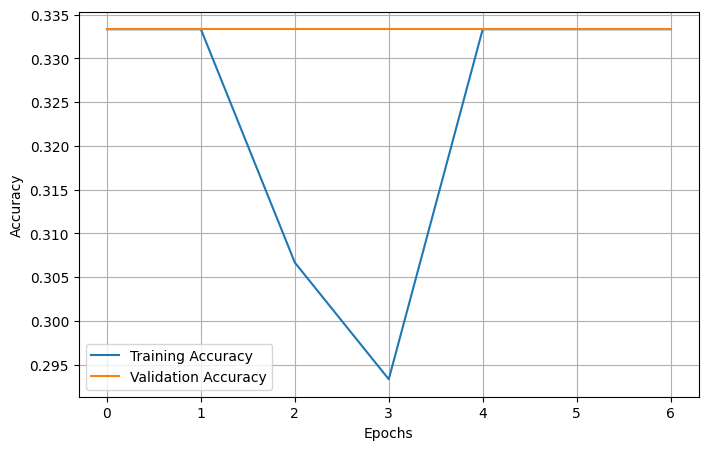

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━

In [6]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping

# === 1. Ordnernamen anpassen ===
folders = ["Arbeit", "Finanzen", "Werbung"]
base_path = "data"

# === 2. Datenimport: CSV-Dateien laden ===
def load_data_from_folders(base_path, folders):
    data = []
    for folder in folders:
        folder_path = os.path.join(base_path, folder)
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                file_path = os.path.join(folder_path, file)
                csv_data = pd.read_csv(file_path, encoding="ISO-8859-1")  # Falls nötig "latin1"
                for _, row in csv_data.iterrows():
                    data.append({
                        "Betreff": row.get("Betreff", ""),
                        "Inhalt": row.get("Inhalt", ""),
                        "Label": folder
                    })
    return pd.DataFrame(data)

data = load_data_from_folders(base_path, folders)

# === 3. Datenaufteilung in Training und Test ===
train_data, test_data = train_test_split(data, test_size=0.5, random_state=42, stratify=data["Label"])

# === 4. Tokenisierung ===
tokenizer = Tokenizer(num_words=10000, oov_token="UNK")
tokenizer.fit_on_texts(train_data["Inhalt"])

x_train = tokenizer.texts_to_matrix(train_data["Inhalt"], mode="count")
x_test = tokenizer.texts_to_matrix(test_data["Inhalt"], mode="count")

label_map = {folder: idx for idx, folder in enumerate(folders)}
y_train = to_categorical(train_data["Label"].map(label_map), num_classes=len(folders))
y_test = to_categorical(test_data["Label"].map(label_map), num_classes=len(folders))

# === 5. Modell erstellen ===
model = Sequential([
    Dense(128, activation='relu', input_shape=(x_train.shape[1],)),
    Dense(64, activation='relu'),
    Dense(len(folders), activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# === 6. Early Stopping ===
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# === 7. Modell trainieren ===
history = model.fit(
    x_train, y_train,
    epochs=200,  # Reduziert auf 200, kann erhöht werden
    batch_size=32,  # Größerer Batch für stabileres Training
    validation_data=(x_test, y_test),
    callbacks=[early_stopping]
)

# === 8. Plot der Accuracy ===
plt.figure(figsize=(8,5))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()
plt.grid()
plt.show()

# === 9. Modell speichern ===
model.save('2 AI epochs___ V1.4.h5')

# === 10. Evaluierung des Modells ===
def evaluate_model(test_data, tokenizer, model, folders):
    correct_counts = {folder: 0 for folder in folders}
    total_counts = {folder: 0 for folder in folders}
    
    for i in range(len(test_data)):
        x = tokenizer.texts_to_matrix([test_data["Inhalt"].iloc[i]], mode="count")
        prediction = model.predict(x)
        predicted_label = folders[np.argmax(prediction)]
        true_label = test_data["Label"].iloc[i]
        
        if predicted_label == true_label:
            correct_counts[true_label] += 1
        total_counts[true_label] += 1

    print("\nErgebnis der Klassifikation:")
    for folder in folders:
        correct = correct_counts[folder]
        total = total_counts[folder]
        accuracy = (correct / total) * 100 if total > 0 else 0
        print(f"✅ {folder}: {correct} von {total} korrekt ({accuracy:.2f}%)")

evaluate_model(test_data, tokenizer, model, folders)
